In [1]:
import scvelo as scv
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
path_to_write='/media/sergio/Meninges/SpatialData_formatted/'

In [3]:
adata=sc.read(path_to_write+'adata_for_velocity_pcw9_processed.h5ad')

# Subset_clusters_involved_in_trajectory

In [4]:
clusters=['7','1','0','5']
adata=adata[adata.obs['leiden'].isin(clusters)]

2024-07-15 13:30:57.359341: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-07-15 13:30:57.396625: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-07-15 13:30:57.664595: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-07-15 13:30:57.667839: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-07-15 13:30:58.624117: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Co

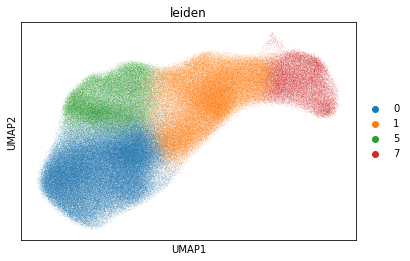

In [5]:
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.pl.umap(adata,color='leiden')

In [ ]:
#adata.write(path_to_write+'adata_for_velocity_pcw9_processed_trajectory_input.h5ad')

# Run RNA velocity and explore

computing moments based on connectivities
    finished (0:00:07) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/32 cores)


  0%|          | 0/296043 [00:00<?, ?cells/s]

    finished (0:03:28) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:01:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


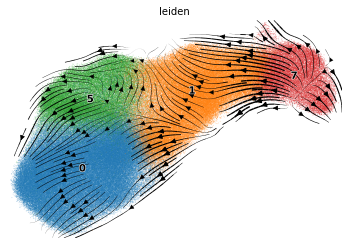

In [25]:
scv.pp.moments(adata, n_pcs=None, n_neighbors=None)
scv.tl.velocity(adata, mode='deterministic')
scv.tl.velocity_graph(adata)
scv.pl.velocity_embedding_stream(adata, basis='umap', color='leiden')

In [24]:
adata.layers['velocity'].shape

(296043, 84)

computing moments based on connectivities
    finished (0:00:15) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:39) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/32 cores)


  0%|          | 0/296043 [00:00<?, ?cells/s]

    finished (0:03:48) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:01:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


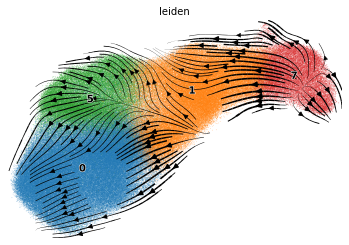

In [13]:
scv.pp.moments(adata, n_pcs=None, n_neighbors=None)
scv.tl.velocity(adata, mode='stochastic',filter_genes=True)
scv.tl.velocity_graph(adata)
scv.pl.velocity_embedding_stream(adata, basis='umap', color='leiden')

In [26]:
scv.tl.VELOVI(adata)

AttributeError: module 'scvelo.tools' has no attribute 'VELOVI'

In [23]:
adata.layers['velocity'].shape

(296043, 84)

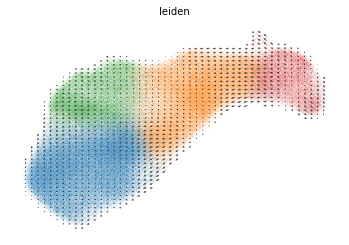

In [9]:
scv.pl.velocity_embedding_grid(adata, basis='umap', color='leiden')

In [10]:
adata.write(path_to_write+'adata_for_velocity_pcw9_processed_trajectory_output_allgenes.h5ad')
#adata=sc.read(path_to_write+'adata_for_velocity_pcw9_processed_trajectory_output.h5ad')

In [9]:
scv.tl.recover_dynamics(adata)

recovering dynamics (using 1/32 cores)


  0%|          | 0/84 [00:00<?, ?gene/s]

    finished (0:56:13) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [10]:
adata.write(path_to_write+'adata_for_velocity_pcw9_processed_trajectory_with_dynamics.h5ad')

# Generate pseudotime

In [136]:
adata2=adata.copy()
adata2.obs=adata2.obs.reset_index()
asub=adata2[adata2.obs['leiden']=='7']
asub.obs.index=asub.obs.index.astype(str)
for a in asub.obs['cell_id'].unique():
    asub2=asub[asub.obs['cell_id']==a]
    plt.figure(figsize=(4,4))
    plt.scatter(adata.obsm['X_umap'][:,0],adata.obsm['X_umap'][:,1],c='lightgrey',s=1)
    plt.scatter(asub2.obsm['X_umap'][:,0],asub2.obsm['X_umap'][:,1],c='blue',s=1)
    plt.title(asub2.obs.index[0])
    plt.show()

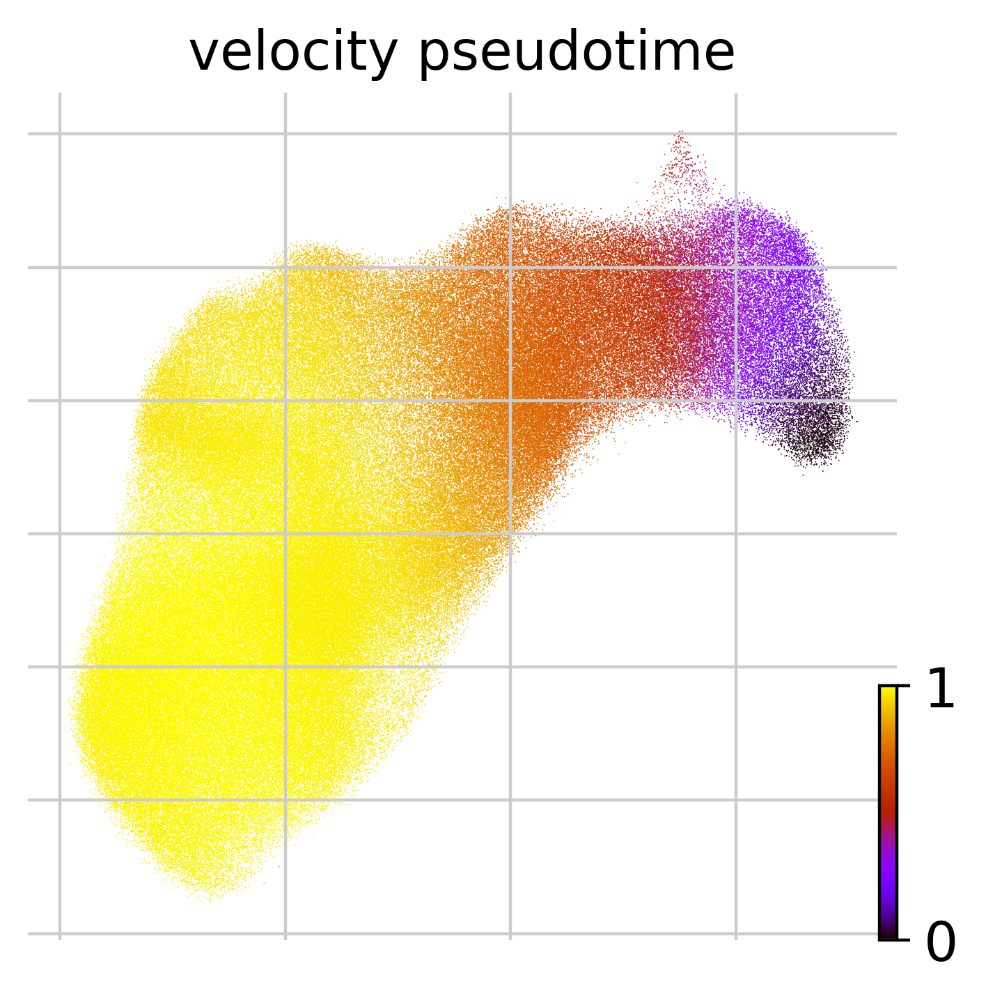

In [142]:
scv.tl.velocity_pseudotime(adata,root_key=59)
scv.pl.scatter(adata, color='velocity_pseudotime', cmap='gnuplot')

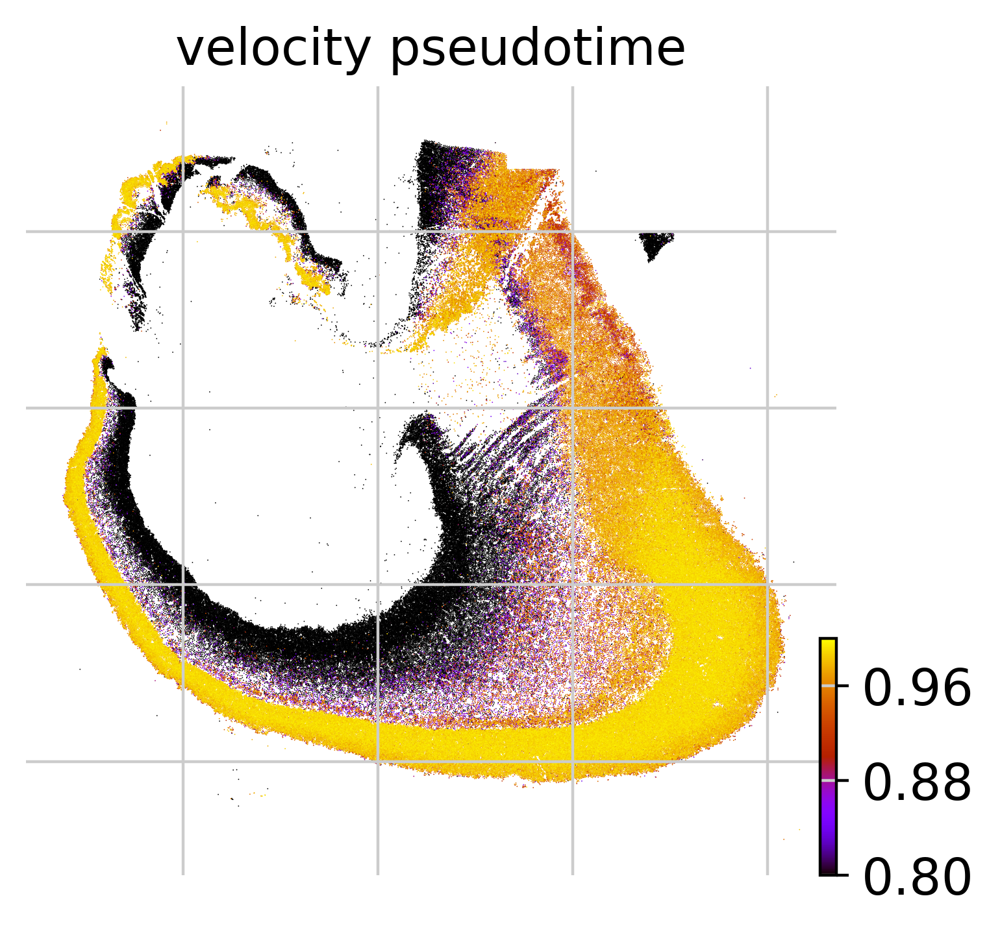

In [190]:
scv.pl.scatter(adata, color='velocity_pseudotime', cmap='gnuplot',basis='spatial',vmin=0.8)

# Explore gene-specific dynamics

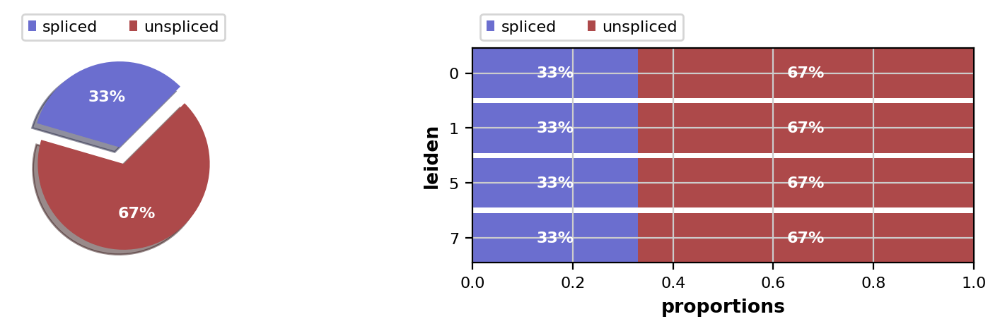

In [182]:
scv.pl.proportions(adata,groupby='leiden')

We define how many genes are considered velocity genes

In [143]:
print('A total of ',np.sum(adata.var['velocity_genes'] == True),' genes are velocity genes')

A total of  84  genes are velocity genes


In [289]:
adata.var.columns

Index(['gene_name', 'Ensemble ID', 'feature_types', 'genome', 'n_cells',
       'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2',
       'velocity_genes', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_',
       'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0',
       'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s',
       'fit_variance', 'fit_alignment_scaling', 'fit_r2'],
      dtype='object')

We first identify which genes have expression in the trajectory

In [144]:
adata.var.index=adata.var['gene_name']
likelihood_genes = adata.var['fit_likelihood'].sort_values(ascending=False)
likelihood_genes=pd.DataFrame(likelihood_genes[likelihood_genes>0])
sum_expression=pd.DataFrame(np.sum(adata.to_df(),axis=0),columns=['sum_expression'])

In [145]:
likelihood_n_expression=pd.concat([likelihood_genes,sum_expression],axis=1)

Text(0, 0.5, 'Sum_expression')

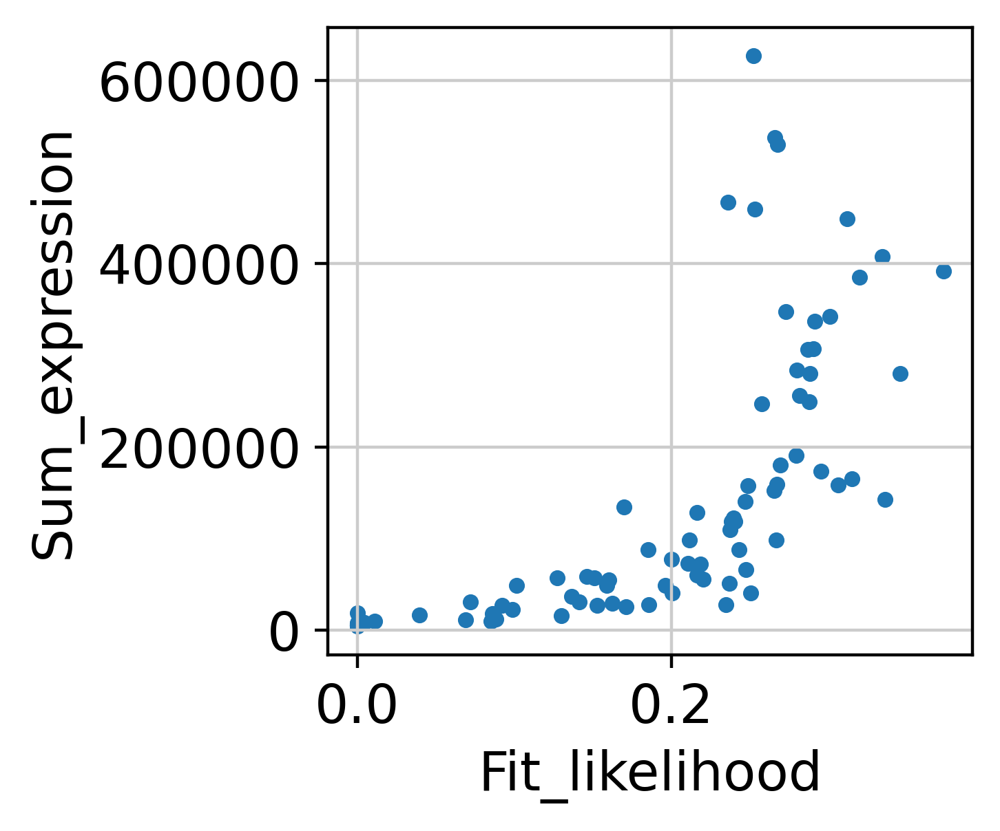

In [146]:
plt.figure(figsize=(3,3))
plt.scatter(likelihood_n_expression['fit_likelihood'],likelihood_n_expression['sum_expression'],s=10)
plt.xlabel('Fit_likelihood')
plt.ylabel('Sum_expression')

### We plot genes with highest likelihood

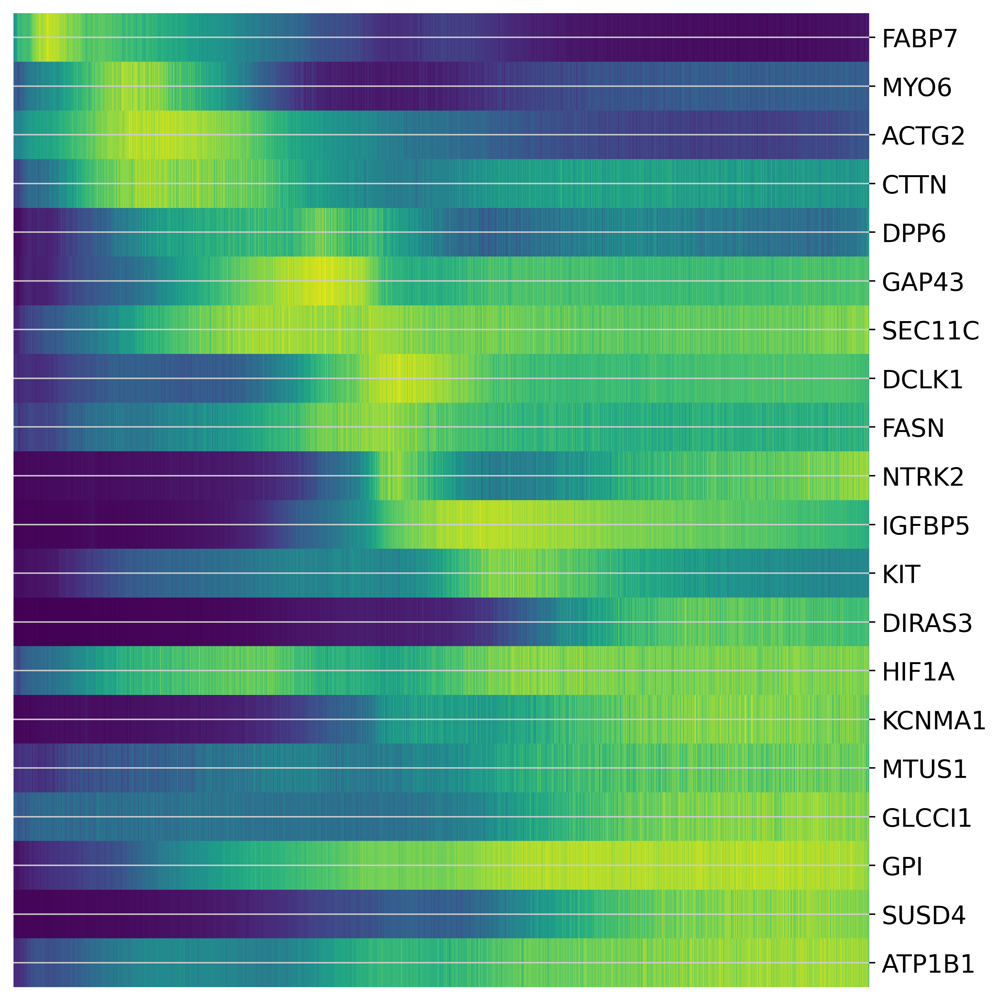

In [147]:
scv.pl.heatmap(adata, var_names=likelihood_genes.index[0:20], sortby='velocity_pseudotime',  n_convolve=100,figsize=(8,8))

### We plot genes with lowest likelihood

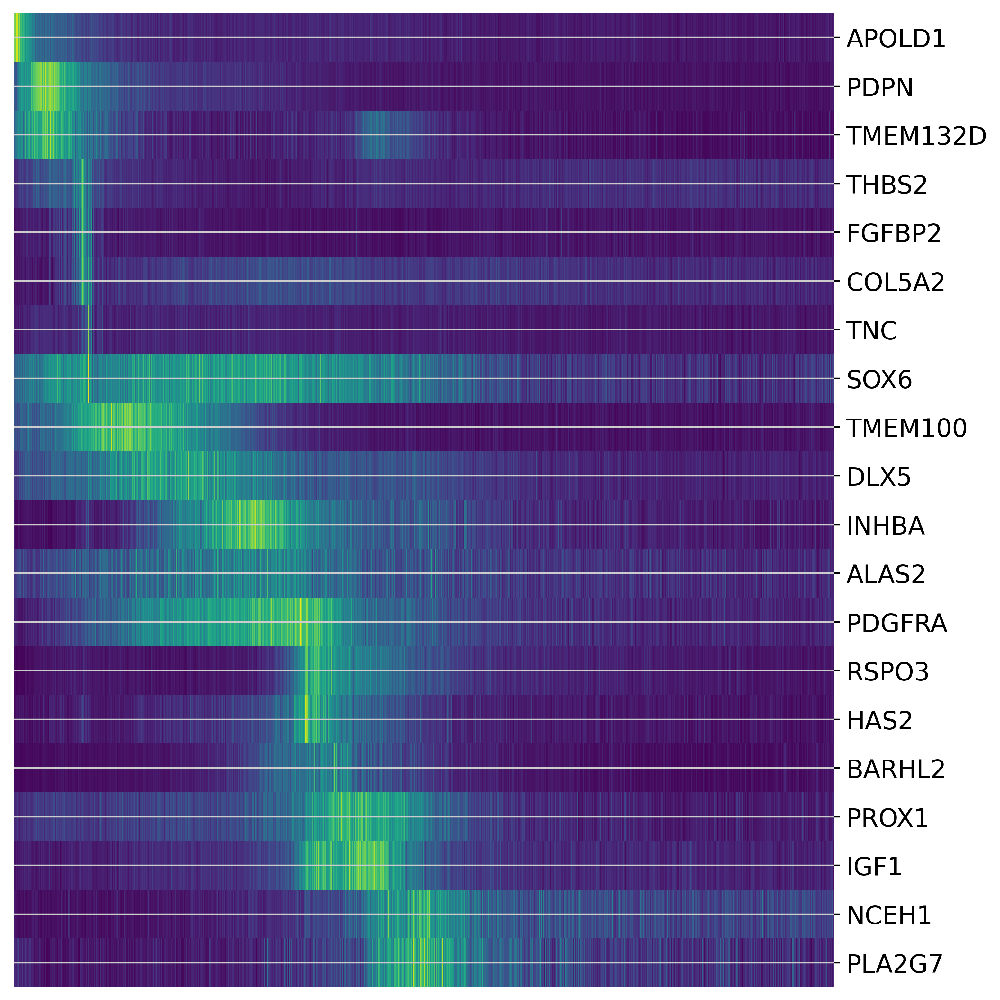

In [148]:
scv.pl.heatmap(adata, var_names=likelihood_genes.index[-20:], sortby='velocity_pseudotime',  n_convolve=100,figsize=(8,8))

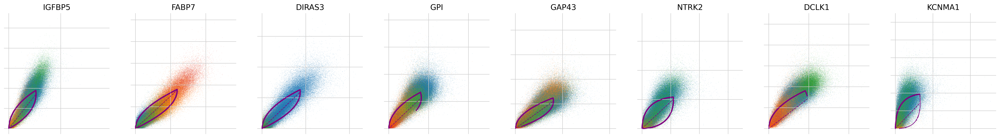

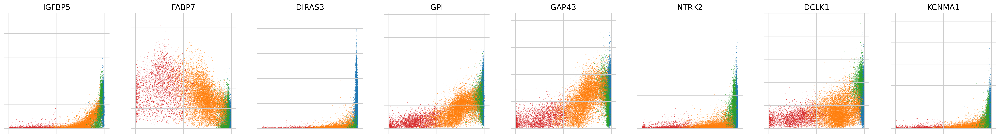

In [149]:
var_names = likelihood_genes.index[0:8]
scv.pl.scatter(adata, var_names, frameon=False,color='leiden')
scv.pl.scatter(adata, x='velocity_pseudotime', y=var_names, frameon=False,color='leiden')


# Plot spliced and unspliced counts against pseudotime

In [ ]:

var_names = likelihood_genes.index[15:25]

spliced=pd.DataFrame(adata.layers['spliced'],columns=adata.var.index,index=adata.obs.index)
unspliced=pd.DataFrame(adata.layers['unspliced'],columns=adata.var.index,index=adata.obs.index)
#spliced=np.log(spliced+0.1)
#unspliced=np.log(unspliced+0.1)
spliced['velocity_pseudotime']=np.round(adata.obs['velocity_pseudotime'],2)
unspliced['velocity_pseudotime']=np.round(adata.obs['velocity_pseudotime'],2)
spliced=spliced.groupby('velocity_pseudotime').mean()
unspliced=unspliced.groupby('velocity_pseudotime').mean()


sns.set_style("whitegrid", {'axes.grid' : False})
for g in var_names:
    plt.figure(figsize=(5,2))
    comb=pd.concat([unspliced.loc[:,[g]],spliced.loc[:,[g]]],axis=1)
    comb.columns=['unspliced','spliced']
    comb=comb.transpose()
    #comb=np.log(comb+1)
    comb=comb.div(np.max(comb,axis=1),axis=0)
    sns.heatmap(comb)
    plt.title(g)
    plt.show()
    plt.figure(figsize=(4,2))
    comb.transpose().plot()
    plt.title(g)
    plt.show()

In [284]:
adata

AnnData object with n_obs × n_vars = 296043 × 389
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'total_counts', 'cell_area', 'nucleus_area', 'n_counts', 'leiden', 'velocity_self_transition', 'root_cells', 'end_points', 'velocity_pseudotime'
    var: 'gene_name', 'Ensemble ID', 'feature_types', 'genome', 'n_cells', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'fit_r2'
    uns: 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'velocity_graph', 'velocity_graph_neg', 'velocity_params', 'recover_dynamics'
    obsm: 'X_pca', 'X_umap', 'spatial', 'velocity_umap', 'X_spatial'
    varm: 'PCs', 'loss'
    layers: 'Ms', 'Mu', 'raw', 'spliced', 'unspliced', 'variance_velocity', 'velocity', 'fit_t

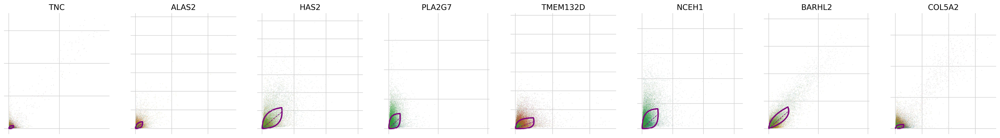

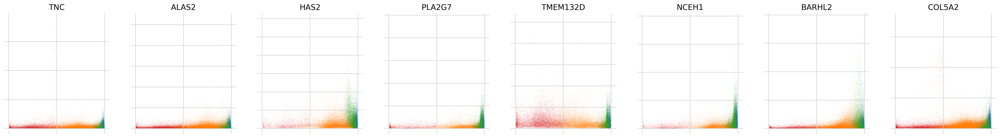

In [150]:
var_names = likelihood_genes.index[-8:]
scv.pl.scatter(adata, var_names, frameon=False,color='leiden')
scv.pl.scatter(adata, x='velocity_pseudotime', y=var_names, frameon=False,color='leiden')


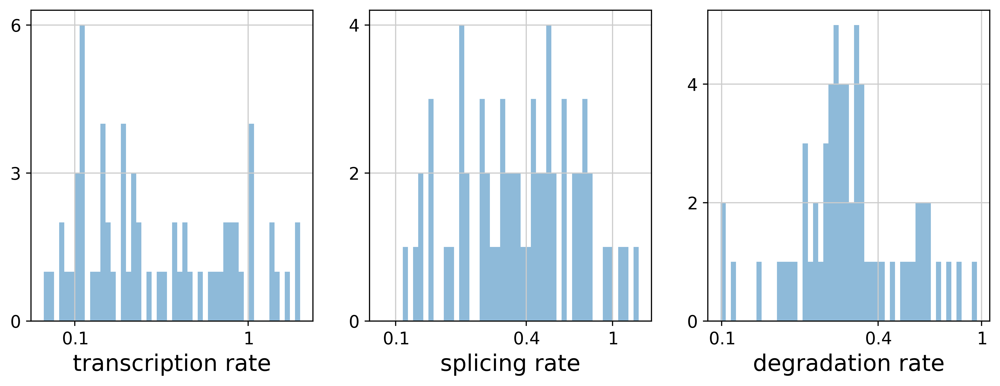

,fit_alpha,fit_beta,fit_gamma,fit_t_,fit_scaling,fit_std_u,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling
gene_name,,,,,,,,,,,,,,,
ACTG2,1.042521,0.435423,0.579566,11.675273,0.731242,0.763339,0.493240,3.008126e-01,0.0,0.0,0.411133,2.007403,1.304485,1.101957,1.413319
ALAS2,0.074426,0.391606,0.279394,6.796100,1.400865,0.054089,0.047299,2.252851e-165,0.0,0.0,0.407670,0.213706,0.181208,2.523148,1.914009
APOLD1,0.065297,0.169825,0.306884,5.535928,5.356865,0.113407,0.036678,3.953622e-02,0.0,0.0,0.456093,0.418411,0.124696,2.483296,1.632352
ASCL1,0.194705,0.271267,0.420339,8.740641,2.560466,0.278602,0.146620,2.503955e-01,0.0,0.0,0.344052,0.696145,0.377543,0.750848,1.847667
ATP1B1,0.373274,0.142344,0.218431,14.346763,0.889511,0.691552,0.367346,2.914648e-01,0.0,0.0,0.329613,1.934801,1.006245,0.670473,3.620678


In [151]:
df = adata.var
df = df[(df['fit_likelihood'] > .1) & df['velocity_genes'] == True]

kwargs = dict(xscale='log', fontsize=16)
with scv.GridSpec(ncols=3) as pl:
    pl.hist(df['fit_alpha'], xlabel='transcription rate', **kwargs)
    pl.hist(df['fit_beta'] * df['fit_scaling'], xlabel='splicing rate', xticks=[.1, .4, 1], **kwargs)
    pl.hist(df['fit_gamma'], xlabel='degradation rate', xticks=[.1, .4, 1], **kwargs)

scv.get_df(adata, 'fit*', dropna=True).head()


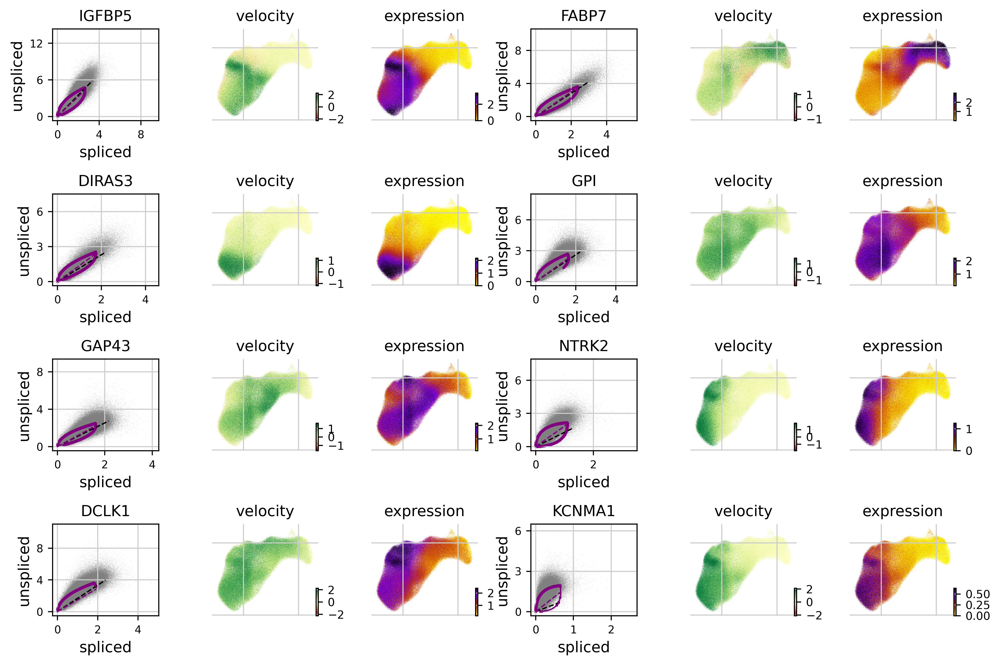

In [186]:
scv.pl.velocity(adata, likelihood_genes.index[:8], ncols=2)

# Runnning dynamical velocity

In [192]:
scv.tl.velocity(adata,mode='dynamical')

computing velocities
    finished (0:01:04) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [193]:
adata.write(path_to_write+'adata_for_velocity_pcw9_processed_trajectory_with_dynamical.h5ad')

computing velocity embedding
    finished (0:01:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


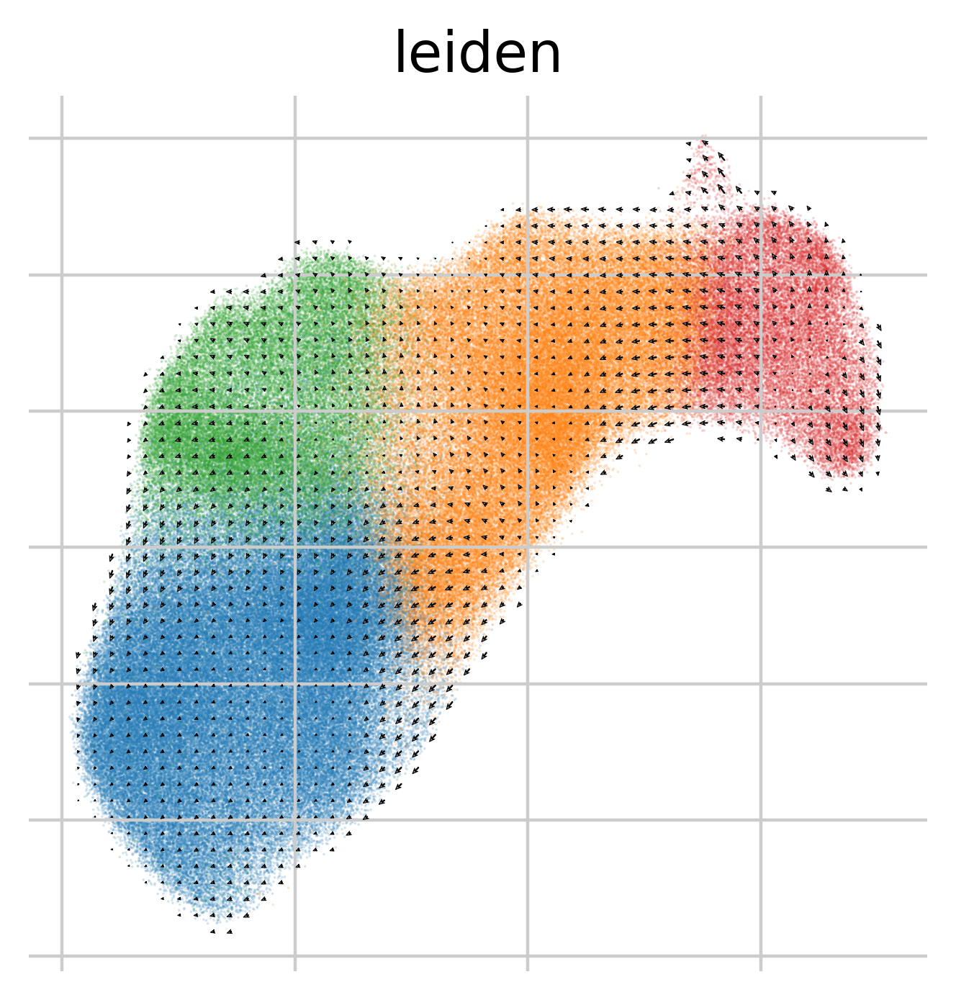

In [194]:
scv.pl.velocity_embedding_grid(adata, basis='umap', color='leiden')

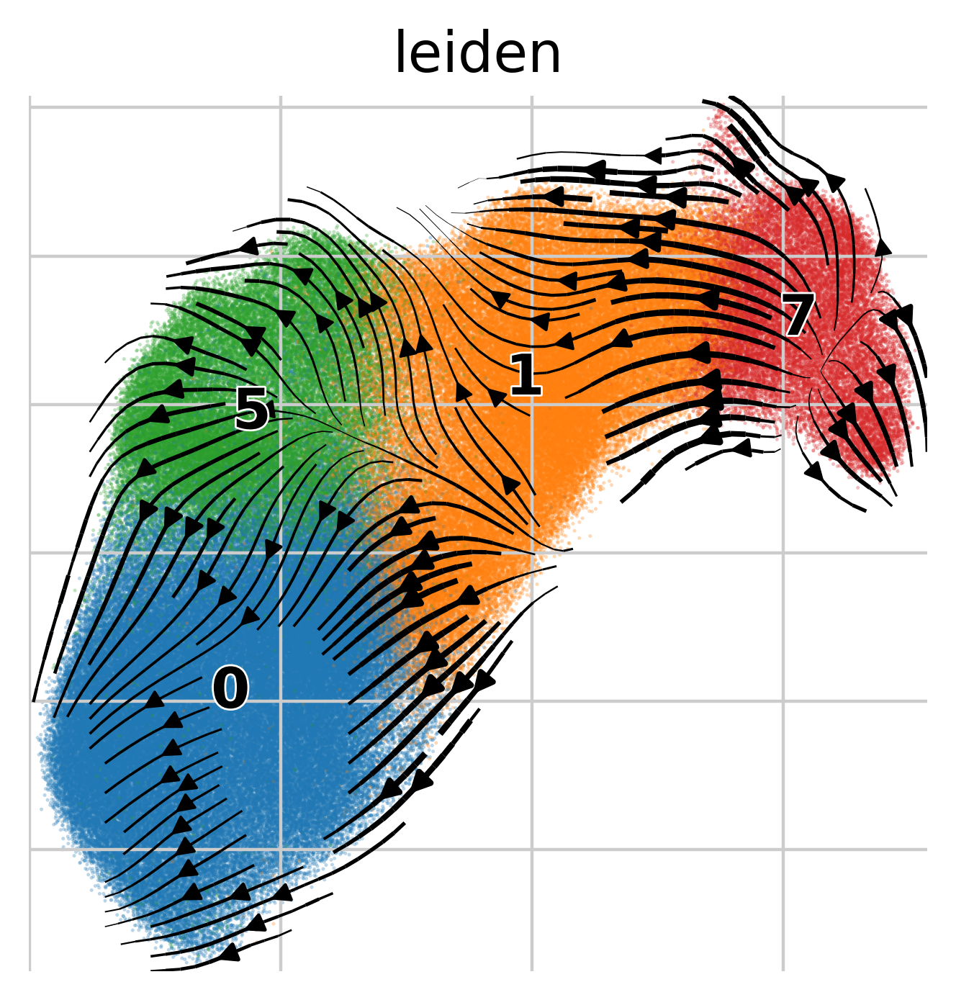

In [195]:
scv.pl.velocity_embedding_stream(adata, basis='umap', color='leiden')

## We explore wether if nuclei-only genes have changes in expression through pseudotime

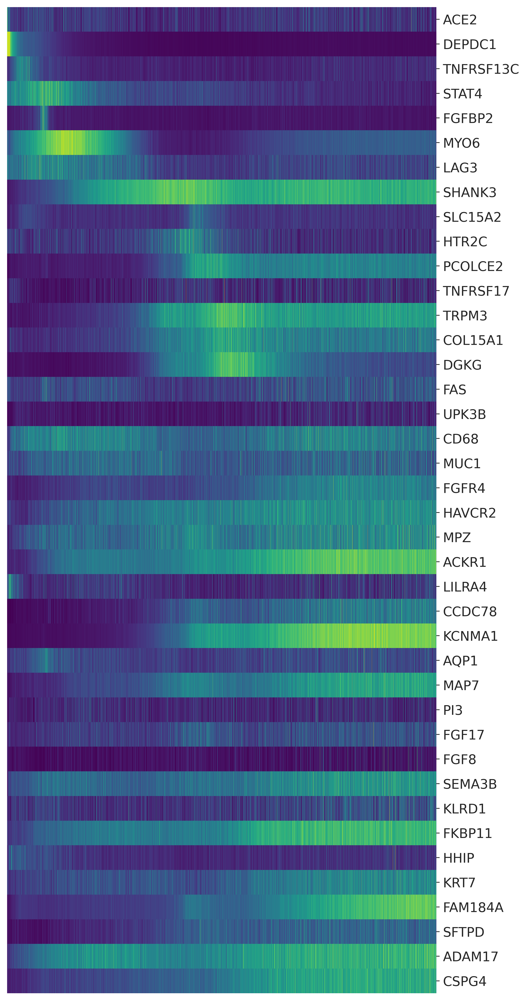

In [334]:
spliced=pd.DataFrame(adata.layers['spliced'],columns=adata.var.index,index=adata.obs.index)
unspliced=pd.DataFrame(adata.layers['unspliced'],columns=adata.var.index,index=adata.obs.index)
spliced_total=pd.DataFrame(spliced.sum(axis=0),columns=['cytoplasm_sum'])
unspliced_total=pd.DataFrame(unspliced.sum(axis=0),columns=['nuclear_sum'])
total_counts=pd.concat([spliced_total,unspliced_total],axis=1)
total_counts=total_counts.div(total_counts.sum(axis=1),axis=0)
total_counts=total_counts.sort_values(by='cytoplasm_sum')
total_counts=total_counts.astype(float)
unstacked_counts=total_counts.unstack().reset_index()
unstacked_counts[0]=unstacked_counts[0].astype(float)
scv.pl.heatmap(adata, var_names=total_counts.index[0:40], sortby='velocity_pseudotime',  n_convolve=100,figsize=(8,15))

In [ ]:
scv.pl.heatmap(adata, var_names=top_genes, sortby='velocity_pseudotime',  n_convolve=100)

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)


/home/sergio/.local/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()


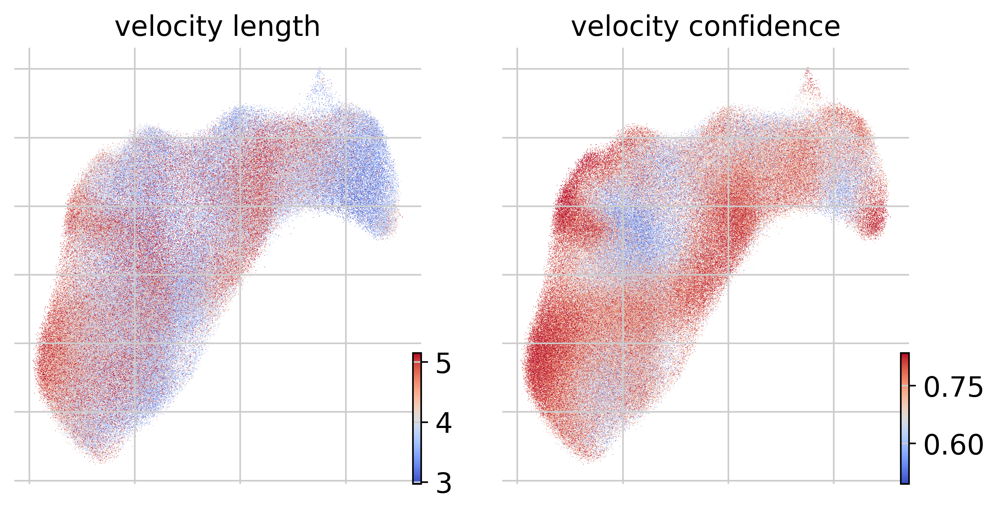

In [23]:
scv.tl.velocity_confidence(adata)
keys = 'velocity_length', 'velocity_confidence'

#with warnings.catch_warnings():
#    warnings.simplefilter("ignore")
scv.pl.scatter(adata, c=keys, cmap='coolwarm', perc=[5, 95])

In [30]:
adata.var.index=adata.var['gene_name']
scv.tl.rank_velocity_genes(adata, groupby='leiden', min_corr=.3)
df = scv.get_df(adata.uns['rank_velocity_genes']['names'])
df.head(6)

ranking velocity genes
    finished (0:00:01) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


,0,1,5,7
0,SUSD4,CD24,SVEP1,FOXM1
1,KCNMA1,MOXD1,ICA1,MIS18BP1
2,CCN3,HMGCS1,NTRK2,EMX2
3,CDH1,DPP6,IGFBP3,NES
4,PLCL1,ACTG2,SHANK3,PAX6
5,TLE2,SSTR2,KCNMA1,SSTR2


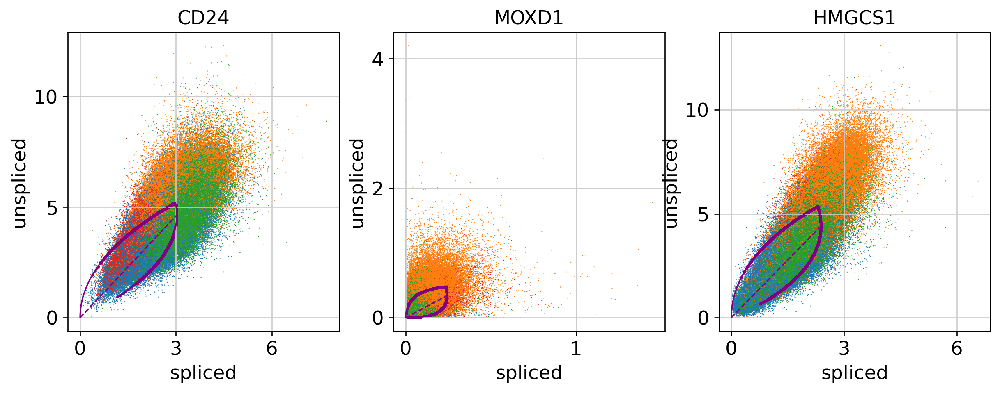

In [35]:
#with warnings.catch_warnings():
#    warnings.simplefilter("ignore")
scv.pl.scatter(adata, df['1'][:3],color="leiden",dpi=120,size=2)

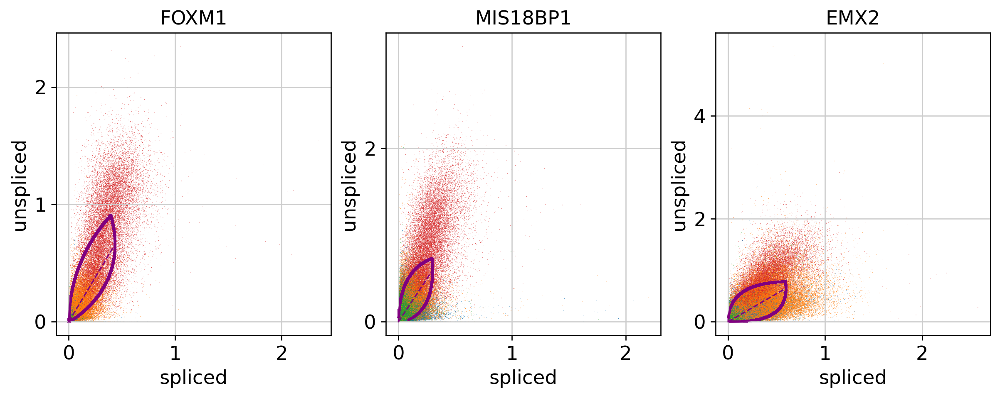

In [34]:
#with warnings.catch_warnings():
#    warnings.simplefilter("ignore")
scv.pl.scatter(adata, df['7'][:3],color="leiden",dpi=120)